<a href="https://colab.research.google.com/github/BahPullo/Machine-learning-/blob/main/01_Object_Detection_API_Eager_Few_Shot_Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

TensorFlow Object Detection API  
https://github.com/tensorflow/models/tree/master/research/object_detection  
code resource:  
https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/eager_few_shot_od_training_tf2_colab.ipynb

# 0 Imports

In [25]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [26]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1691106 sha256=c123b95361463607b953cc799c97819b2bda8e208d48127ce7dfeeab209aa8d6
  Stored in directory: /tmp/pip-ephem-wheel-cache-5kletyib/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [27]:
import matplotlib
import matplotlib.pyplot as plt

import os, random, io, imageio, glob, json
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

from sklearn.model_selection import train_test_split
from xml.etree import cElementTree as ElementTree

# 1 Utilities

In [28]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

# 2 Data preparation

In [29]:
# Download and unzip dataset from google drive shared file:
# https://drive.google.com/file/d/1FLU8c9PSZBSrRFH3nFW-EPAFZpRWK0Dw/view?usp=sharing
!pip install -q --upgrade --no-cache-dir gdown
!gdown --id 1FLU8c9PSZBSrRFH3nFW-EPAFZpRWK0Dw
!unzip -n -q 'OBJ_Train_Datasets.zip' -d .
print("... done")

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1FLU8c9PSZBSrRFH3nFW-EPAFZpRWK0Dw
To: /content/OBJ_Train_Datasets.zip
100% 340M/340M [00:01<00:00, 196MB/s]
... done


In [30]:
OBJ_data_root = "OBJ_Train_Datasets"

image_file_list = sorted(glob.glob(OBJ_data_root + "/Train_Images/*.jpg"))
print("Found image files:", len(image_file_list), "\tfirst image file =", image_file_list[0])
# get all case_name
sample_id_arr = np.array([int(f.split("/")[-1].split(".")[0]) for f in image_file_list])
print("sample_id_arr =", sample_id_arr)

Found image files: 1053 	first image file = OBJ_Train_Datasets/Train_Images/00000000.jpg
sample_id_arr = [   0    1    2 ... 1050 1051 1052]


In [31]:
# split train and valid set
sample_id_train, sample_id_valid, = train_test_split(sample_id_arr, test_size=0.2, random_state=42)
print(f"sample_id_train({len(sample_id_train)}) =", sample_id_train.tolist())
print(f"sample_id_valid({len(sample_id_valid)}) =", sample_id_valid.tolist())

sample_id_train(842) = [786, 261, 299, 713, 990, 697, 548, 447, 873, 209, 908, 1018, 481, 611, 404, 60, 917, 707, 92, 864, 833, 519, 715, 483, 966, 866, 907, 428, 361, 398, 286, 328, 292, 499, 182, 478, 110, 532, 529, 944, 542, 462, 409, 296, 442, 306, 785, 486, 789, 137, 309, 811, 298, 601, 582, 29, 165, 248, 354, 688, 405, 665, 827, 528, 65, 381, 1006, 254, 721, 331, 221, 235, 370, 545, 308, 590, 978, 249, 583, 793, 71, 94, 33, 997, 259, 204, 390, 749, 371, 77, 84, 359, 82, 934, 439, 479, 692, 602, 1049, 716, 5, 310, 485, 104, 97, 323, 501, 314, 430, 940, 281, 266, 1023, 700, 365, 892, 948, 844, 118, 1017, 250, 411, 285, 1031, 9, 388, 196, 655, 81, 453, 535, 889, 239, 351, 211, 777, 432, 992, 227, 928, 924, 974, 177, 1012, 830, 436, 534, 380, 981, 613, 7, 155, 357, 728, 223, 329, 539, 477, 843, 614, 734, 626, 1011, 615, 530, 622, 631, 765, 722, 163, 228, 425, 790, 212, 829, 79, 148, 302, 882, 584, 566, 413, 43, 408, 133, 596, 311, 516, 682, 518, 854, 973, 0, 360, 382, 316, 764, 593, 

In [32]:
# define function for getting data via sample_id
def get_image(sample_id, target_size=None):
    pil_image = Image.open(f"{OBJ_data_root}/Train_Images/{sample_id:08d}.jpg")
    if target_size is not None:
        pil_image.resize(target_size)
    return np.array(pil_image)

def get_bbox(sample_id):
    # read bonding-boxes from xml file
    xml_file = f"{OBJ_data_root}/Train_Annotations/{sample_id:08d}.xml"
    tree = ElementTree.parse(xml_file)
    root = tree.getroot()
    # get image size
    size = root.find('size')
    image_w = int(size.find('width').text)
    image_h = int(size.find('height').text)
    # find all bonding boxes
    bbox_list = []
    for obj in root.iter('object'):
        name = obj.find('name').text.upper()
        if name == "STAS":  # collect all STAS bonding-box
            anno = obj.find('bndbox')
            xmin = int(anno.find('xmin').text) / image_w
            ymin = int(anno.find('ymin').text) / image_h
            xmax = int(anno.find('xmax').text) / image_w
            ymax = int(anno.find('ymax').text) / image_h
            bbox_list.append([ymin, xmin, ymax, xmax])  # <-- bbox format for TensorFlow Object Detection API
    return np.array(bbox_list)

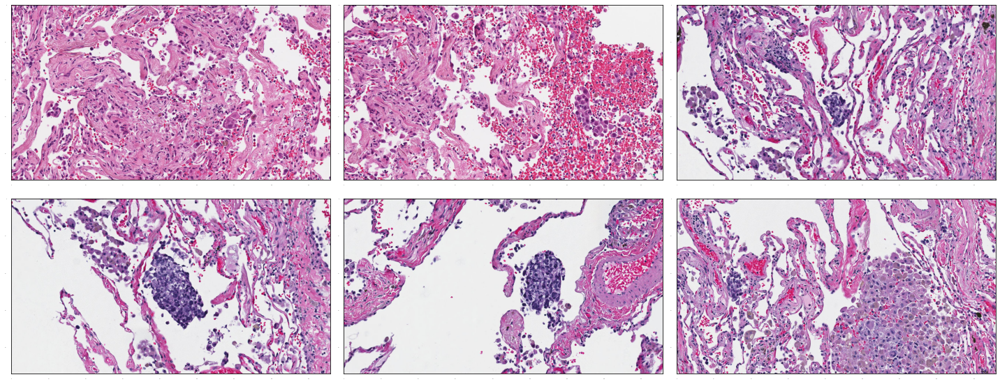

In [33]:
# Load some images and visualize
image_list = []
for sample_id in sample_id_arr[:6]:
    image_list.append(get_image(sample_id))

# plot
plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [20, 8]
for idx, one_image in enumerate(image_list):
  plt.subplot(2, 3, idx+1)
  plt.imshow(one_image)
plt.tight_layout()
plt.show()

In [34]:
# Load some label boxes
bbox_list = []
for sample_id in sample_id_arr[:6]:
    print("sample_id =", sample_id)
    bbox = get_bbox(sample_id)
    print(bbox)
    bbox_list.append(bbox)

sample_id = 0
[[0.55307856 0.10780886 0.64437367 0.15675991]
 [0.60615711 0.66142191 0.70806794 0.71969697]]
sample_id = 1
[[0.4670913  0.72144522 0.75690021 0.83216783]
 [0.84076433 0.84207459 0.91932059 0.87004662]
 [0.35987261 0.89160839 0.42250531 0.92016317]]
sample_id = 2
[[0.47770701 0.44289044 0.52229299 0.46095571]
 [0.49787686 0.45629371 0.70382166 0.54545455]]
sample_id = 3
[[0.30573248 0.40967366 0.7462845  0.61771562]
 [0.27707006 0.50582751 0.35244161 0.5483683 ]]
sample_id = 4
[[0.28874735 0.55361305 0.66454352 0.69638695]
 [0.63269639 0.63578089 0.74416136 0.68997669]]
sample_id = 5
[[0.40021231 0.1532634  0.61252654 0.20862471]]


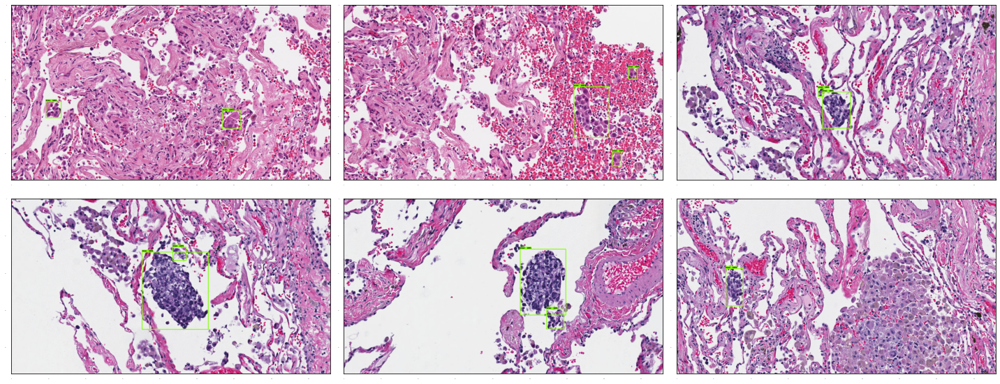

In [35]:
# By convention, our non-background classes start counting at 1.  Given
# that we will be predicting just one class, we will therefore assign it a
# `class id` of 1.
STAS_class_id = 1
num_classes = 1

category_index = {STAS_class_id: {'id': STAS_class_id, 'name': 'STAS'}}

plt.figure(figsize=(20, 8))
for idx in range(6):
  plt.subplot(2, 3, idx+1)
  plot_detections(image_list[idx], 
                  boxes=bbox_list[idx], 
                  classes=np.ones(shape=[bbox_list[idx].shape[0]], dtype=np.int32), 
                  scores=np.ones(shape=[bbox_list[idx].shape[0]], dtype=np.int32), # give boxes a score of 100%
                  category_index=category_index)
plt.tight_layout()
plt.show()

# 4 data processing function

In [36]:
# @tf.function
def train_processing(sample_id):
    def py_preproc(sample_id):  # input tensor
        image = get_image(sample_id)
        bbox = get_bbox(sample_id)
        ## add data augmentations here ##
        classes = np.ones(shape=(bbox.shape[0]), dtype=np.int32)
        return image, bbox, classes
    image, bbox, classes = tf.py_function(py_preproc, [sample_id], [tf.float32, tf.float32, tf.int32])
    image = tf.expand_dims(image, axis=0)
    one_hot_classes = tf.one_hot(classes - 1, num_classes)
    return image, bbox, one_hot_classes

# function test:
sample_id = 0
image, bbox, classes = train_processing(sample_id)
print("image shape =", image.shape)
print("bbox =", bbox)
print("classes =", classes)

image shape = (1, 942, 1716, 3)
bbox = tf.Tensor(
[[0.55307853 0.10780886 0.64437366 0.1567599 ]
 [0.6061571  0.6614219  0.70806795 0.719697  ]], shape=(2, 4), dtype=float32)
classes = tf.Tensor(
[[1.]
 [1.]], shape=(2, 1), dtype=float32)


# 5 Create model and restore weights for all but last layer
In this cell we build a single stage detection architecture (RetinaNet) and restore all but the classification layer at the top (which will be automatically randomly initialized).

For simplicity, we have hardcoded a number of things in this colab for the specific RetinaNet architecture at hand (including assuming that the image size will always be 640x640), however it is not difficult to generalize to other model configurations.

In [37]:
# Download the checkpoint and put it into models/research/object_detection/test_data/

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

--2022-04-28 03:56:23--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.157.128, 2404:6800:4008:c13::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.157.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.1’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   282MB/s    in 0.8s    

2022-04-28 03:56:24 (282 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.1’ saved [244817203/244817203]

mv: cannot move 'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint' to 'models/research/object_detection/test_data/checkpoint': Directory not empty


In [38]:
tf.keras.backend.clear_session()

print('Building model and restoring weights for fine-tuning...', flush=True)
num_classes = 1
pipeline_config = 'models/research/object_detection/configs/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config'
checkpoint_path = 'models/research/object_detection/test_data/checkpoint/ckpt-0'

# Load pipeline config and build a detection model.
#
# Since we are working off of a COCO architecture which predicts 90
# class slots by default, we override the `num_classes` field here to be just
# one (for our new rubber ducky class).
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
model_config.ssd.num_classes = num_classes
model_config.ssd.freeze_batchnorm = True
detection_model = model_builder.build(model_config=model_config, is_training=True)

# Set up object-based checkpoint restore --- RetinaNet has two prediction
# `heads` --- one for classification, the other for box regression.  We will
# restore the box regression head but initialize the classification head
# from scratch (we show the omission below by commenting out the line that
# we would add if we wanted to restore both heads)
fake_box_predictor = tf.compat.v2.train.Checkpoint(
    _base_tower_layers_for_heads=detection_model._box_predictor._base_tower_layers_for_heads,
    # _prediction_heads=detection_model._box_predictor._prediction_heads,
    #    (i.e., the classification head that we *will not* restore)
    _box_prediction_head=detection_model._box_predictor._box_prediction_head,
    )
fake_model = tf.compat.v2.train.Checkpoint(
          _feature_extractor=detection_model._feature_extractor,
          _box_predictor=fake_box_predictor)
ckpt = tf.compat.v2.train.Checkpoint(model=fake_model)
ckpt.restore(checkpoint_path).expect_partial()

# Run model through a dummy image so that variables are created
image, shapes = detection_model.preprocess(tf.zeros([1, 640, 640, 3]))
prediction_dict = detection_model.predict(image, shapes)
_ = detection_model.postprocess(prediction_dict, shapes)
print('Weights restored!')

Building model and restoring weights for fine-tuning...
Weights restored!


# 6 Eager mode custom training loop

In [39]:
tf.keras.backend.set_learning_phase(True)

# These parameters can be tuned; since our training set has 5 images
# it doesn't make sense to have a much larger batch size, though we could
# fit more examples in memory if we wanted to.
batch_size = 8
learning_rate = 0.01
num_batches = 100

# Select variables in top layers to fine-tune.
trainable_variables = detection_model.trainable_variables
to_fine_tune = []
prefixes_to_train = [
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead',
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead']
for var in trainable_variables:
  if any([var.name.startswith(prefix) for prefix in prefixes_to_train]):
    to_fine_tune.append(var)

# Set up forward + backward pass for a single train step.
def get_model_train_step_function(model, optimizer, vars_to_fine_tune):
  """Get a tf.function for training step."""

  # Use tf.function for a bit of speed.
  # Comment out the tf.function decorator if you want the inside of the
  # function to run eagerly.
  @tf.function
  def train_step_fn(image_tensors,
                    groundtruth_boxes_list,
                    groundtruth_classes_list):
    """A single training iteration.

    Args:
      image_tensors: A list of [1, height, width, 3] Tensor of type tf.float32.
        Note that the height and width can vary across images, as they are
        reshaped within this function to be 640x640.
      groundtruth_boxes_list: A list of Tensors of shape [N_i, 4] with type
        tf.float32 representing groundtruth boxes for each image in the batch.
      groundtruth_classes_list: A list of Tensors of shape [N_i, num_classes]
        with type tf.float32 representing groundtruth boxes for each image in
        the batch.

    Returns:
      A scalar tensor representing the total loss for the input batch.
    """
    shapes = tf.constant(batch_size * [[640, 640, 3]], dtype=tf.int32)
    model.provide_groundtruth(
        groundtruth_boxes_list=groundtruth_boxes_list,
        groundtruth_classes_list=groundtruth_classes_list)
    with tf.GradientTape() as tape:
      preprocessed_images = tf.concat(
          [detection_model.preprocess(image_tensor)[0]
           for image_tensor in image_tensors], axis=0)
      prediction_dict = model.predict(preprocessed_images, shapes)
      losses_dict = model.loss(prediction_dict, shapes)
      total_loss = losses_dict['Loss/localization_loss'] + losses_dict['Loss/classification_loss']
      gradients = tape.gradient(total_loss, vars_to_fine_tune)
      optimizer.apply_gradients(zip(gradients, vars_to_fine_tune))
    return total_loss

  return train_step_fn

optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
train_step_fn = get_model_train_step_function(detection_model, optimizer, to_fine_tune)

print('Start fine-tuning!', flush=True)
for idx in range(num_batches):
  # Grab keys for a random subset of examples
  all_keys = sample_id_train.tolist()
  random.shuffle(all_keys)
  example_keys = all_keys[:batch_size]

  # Note that we do not do data augmentation in this demo.  If you want a
  # a fun exercise, we recommend experimenting with random horizontal flipping
  # and random cropping :)
  image_tensors = []
  gt_boxes_list = []
  gt_classes_list = []
  for key in example_keys:
    image, bbox, classes = train_processing(sample_id)
    image_tensors.append(image)
    gt_boxes_list.append(bbox)
    gt_classes_list.append(classes)

  # Training step (forward pass + backwards pass)
  total_loss = train_step_fn(image_tensors, gt_boxes_list, gt_classes_list)

  if idx % 10 == 0:
    print('batch ' + str(idx) + ' of ' + str(num_batches)
    + ', loss=' +  str(total_loss.numpy()), flush=True)

print('Done fine-tuning!')

Start fine-tuning!


/usr/local/lib/python3.7/dist-packages/keras/backend.py:450: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


batch 0 of 100, loss=1.3498125
batch 10 of 100, loss=8.955246
batch 20 of 100, loss=8.425566
batch 30 of 100, loss=2.5737164
batch 40 of 100, loss=0.39698502
batch 50 of 100, loss=0.23161094
batch 60 of 100, loss=0.049071267
batch 70 of 100, loss=0.033175398
batch 80 of 100, loss=0.011502274
batch 90 of 100, loss=0.008093592
Done fine-tuning!


# 7 Load some test images and run inference with new model!

In [40]:
test_image_dir = 'models/research/object_detection/test_images/ducky/test/'
test_images_np = []
for i in range(1, 50):
  image_path = os.path.join(test_image_dir, 'out' + str(i) + '.jpg')
  test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(image_path), axis=0))

# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
  """Run detection on an input image.

  Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

  Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
  """
  preprocessed_image, shapes = detection_model.preprocess(input_tensor)
  prediction_dict = detection_model.predict(preprocessed_image, shapes)
  return detection_model.postprocess(prediction_dict, shapes)

# Note that the first frame will trigger tracing of the tf.function, which will
# take some time, after which inference should be fast.

label_id_offset = 1
for sample_id in sample_id_valid[:10]:
    image = get_image(sample_id)
    image = np.expand_dims(image, axis=0)
    input_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    detections = detect(input_tensor)

    plot_detections(
        image[0],
        detections['detection_boxes'][0].numpy(),
        detections['detection_classes'][0].numpy().astype(np.uint32) + label_id_offset,
        detections['detection_scores'][0].numpy(),
        category_index, figsize=(15, 20), image_name=f"pred_{sample_id:08d}.jpg")

Imageio: 'libfreeimage-3.16.0-linux64.so' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/freeimage/libfreeimage-3.16.0-linux64.so (4.6 MB)
Downloading: 8192/4830080 bytes (0.2%)2457600/4830080 bytes (50.9%)4830080/4830080 bytes (100.0%)
  Done
File saved as /root/.imageio/freeimage/libfreeimage-3.16.0-linux64.so.


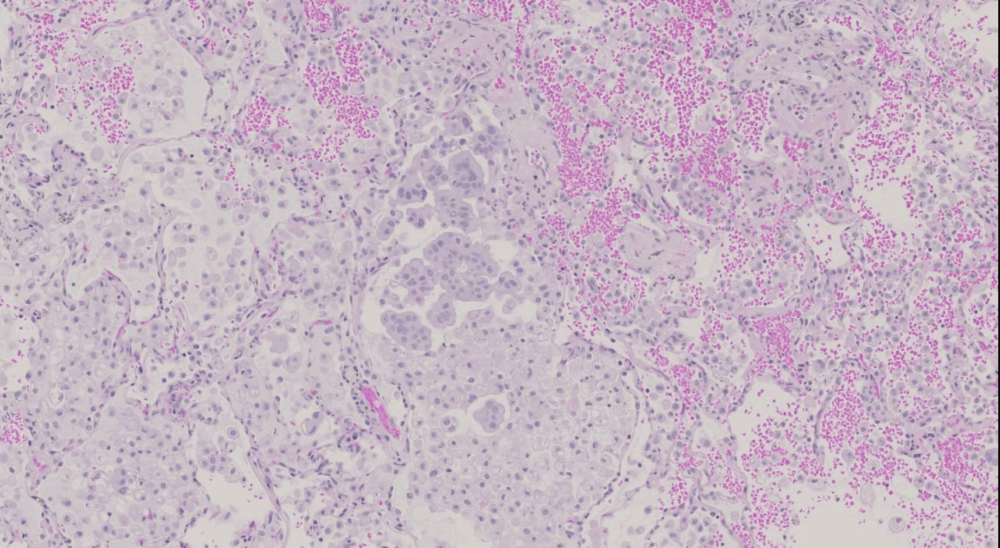

In [41]:
# make pred results as gif animation
imageio.plugins.freeimage.download()

anim_file = 'pred_valid_10.gif'

filenames = glob.glob('pred_*.jpg')
filenames = sorted(filenames)
last = -1
images = []
for filename in filenames:
  image = imageio.imread(filename)
  images.append(image)

imageio.mimsave(anim_file, images, 'GIF-FI', fps=1)

display(IPyImage(open(anim_file, 'rb').read()))

# 8 Predict valid-set

In [42]:
# prediction to submit format
pred_dict = dict()
for i, sample_id in enumerate(sample_id_valid[:]):
    image = get_image(sample_id)
    image_h = image.shape[0]
    image_w = image.shape[1]
    image = np.expand_dims(image, axis=0)
    input_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    detections = detect(input_tensor)
    boxes = detections['detection_boxes'][0].numpy().tolist()
    scores = detections['detection_scores'][0].numpy().tolist()
    # into submit format
    imgName = f"{sample_id:08d}.jpg"
    # [Xmin,Ymin,Xmax,Ymax,Score>0.05]
    coordinates_score_list = [[int(box[1]*image_w), 
                               int(box[0]*image_h), 
                               int(box[3]*image_w), 
                               int(box[2]*image_h), 
                               round(score, 5)] for box, score in zip(boxes, scores) if score > 0.05]
    pred_dict[imgName] = coordinates_score_list[:202]  # candidates 0 to 200
    print(f"[{i+1:03d}/{len(sample_id_valid):03d}]  sample_id={sample_id:08d}")

pred_dict.keys()

[001/211]  sample_id=00000394
[002/211]  sample_id=00000096
[003/211]  sample_id=00000972
[004/211]  sample_id=00001052
[005/211]  sample_id=00000059
[006/211]  sample_id=00000312
[007/211]  sample_id=00000256
[008/211]  sample_id=00000333
[009/211]  sample_id=00000859
[010/211]  sample_id=00000141
[011/211]  sample_id=00000842
[012/211]  sample_id=00000465
[013/211]  sample_id=00000783
[014/211]  sample_id=00000495
[015/211]  sample_id=00000031
[016/211]  sample_id=00000554
[017/211]  sample_id=00001047
[018/211]  sample_id=00000708
[019/211]  sample_id=00000450
[020/211]  sample_id=00001000
[021/211]  sample_id=00000113
[022/211]  sample_id=00000168
[023/211]  sample_id=00000086
[024/211]  sample_id=00000327
[025/211]  sample_id=00000497
[026/211]  sample_id=00000482
[027/211]  sample_id=00000689
[028/211]  sample_id=00000656
[029/211]  sample_id=00000522
[030/211]  sample_id=00000531
[031/211]  sample_id=00000802
[032/211]  sample_id=00000526
[033/211]  sample_id=00000572
[034/211] 

dict_keys(['00000394.jpg', '00000096.jpg', '00000972.jpg', '00001052.jpg', '00000059.jpg', '00000312.jpg', '00000256.jpg', '00000333.jpg', '00000859.jpg', '00000141.jpg', '00000842.jpg', '00000465.jpg', '00000783.jpg', '00000495.jpg', '00000031.jpg', '00000554.jpg', '00001047.jpg', '00000708.jpg', '00000450.jpg', '00001000.jpg', '00000113.jpg', '00000168.jpg', '00000086.jpg', '00000327.jpg', '00000497.jpg', '00000482.jpg', '00000689.jpg', '00000656.jpg', '00000522.jpg', '00000531.jpg', '00000802.jpg', '00000526.jpg', '00000572.jpg', '00000773.jpg', '00000107.jpg', '00000916.jpg', '00000440.jpg', '00000319.jpg', '00000231.jpg', '00000350.jpg', '00000491.jpg', '00000588.jpg', '00000774.jpg', '00001002.jpg', '00000703.jpg', '00000244.jpg', '00000884.jpg', '00000088.jpg', '00000678.jpg', '00000507.jpg', '00000649.jpg', '00000445.jpg', '00000617.jpg', '00000887.jpg', '00000541.jpg', '00000458.jpg', '00000136.jpg', '00000294.jpg', '00000706.jpg', '00000076.jpg', '00000824.jpg', '00000538.jpg

In [43]:
# save as json file
out_file = "pred.json"
with open(out_file, 'w', encoding='utf-8') as f:
    json_string = json.dumps(pred_dict)
    f.write(json_string)

In [44]:
# save tf model
# [TODO]